# Experimentations with the software *Bringing Old Photo Back to Life*
This software was created by the team 

Link to their papers with code page: https://paperswithcode.com/paper/old-photo-restoration-via-deep-latent-space

Link to their research paper: https://arxiv.org/pdf/2009.07047v1.pdf


Link to their github repository: https://github.com/microsoft/Bringing-Old-Photos-Back-to-Life

Link to the data set: https://data.vision.ee.ethz.ch/cvl/DIV2K/

#Preliminary Settings
Set the runtime at GPU.

#Step 1. Setting up the environment and images.

Importing the necessary libraries

In [1]:
import matplotlib.pyplot as plt
import numpy as np
import os
import cv2
from skimage.util import random_noise

Fetching the test images.

In [2]:
from google.colab import drive
drive.mount("/content/drive")

Mounted at /content/drive


Fetching the names of the images.

In [3]:
os.chdir("/content/drive/My Drive/Images/Old Photos")
oldImageFilenames = os.listdir()

os.chdir("/content/drive/My Drive/Images/Dataset Images")
newImageFilenames = os.listdir()

os.chdir("/content/drive/My Drive/Images/")

Fetching the image file with OpenCV.

In [4]:
inputDataSetImages = []
inputOldImages = []

for filename in oldImageFilenames: 
  inputOldImages.append(cv2.imread("./Old Photos/" + filename))

for filename in newImageFilenames: 
  inputDataSetImages.append(cv2.imread("./Dataset Images/" + filename))

os.chdir("/content")
drive.flush_and_unmount()

#Experimentation on the software

List of functions that adds degradation to images.

In [5]:
def applyGaussianBlur(inputImages, sigma = 1):
  gBlurImages = []
  for im in inputImages:
    gBlurImages.append(cv2.GaussianBlur(im, (11,11), sigma))
  return gBlurImages

def applyGaussianNoise(inputImages, value = 0.01):
  gNoiseImages = []
  for im in inputImages:
    gNoise = random_noise(im, mode='gaussian', var=value)
    gNoiseImages.append(np.array(gNoise*255, dtype='uint8'))
  return gNoiseImages

def applyLightingChange(inputImages, alpha = 1.0, beta = 0):
  darkImages = []
  for im in inputImages:
    darkImages.append(cv2.convertScaleAbs(im,alpha=alpha,beta=beta))
  return darkImages

def applySaltAndPepper(inputImages, amount_value = 0.05):
  saltyAndPepperedImages = []
  for im in inputImages:
    sPNoise = random_noise(im, mode='s&p',amount=amount_value)
    saltyAndPepperedImages.append(np.array(sPNoise*255, dtype='uint8'))
  return saltyAndPepperedImages

Adding the noises and damages on the images.

In [6]:
gaussianNoisedImages = applyGaussianBlur(inputDataSetImages, 5)
gaussianNoisedImages = applyGaussianNoise(gaussianNoisedImages, 0.02)

saltPepperNoisedImages = applyGaussianBlur(inputDataSetImages, 5)
saltPepperNoisedImages = applySaltAndPepper(saltPepperNoisedImages, 0.09)

lighterImages = applyLightingChange(inputDataSetImages, 1.5)
gaussianNoisedLighterImages = applyGaussianBlur(lighterImages, 5)
gaussianNoisedLighterImages = applyGaussianNoise(gaussianNoisedLighterImages, 0.02)

Display the images of the dataset and the noised images.

In [ ]:
for inIm, gaussIm, spIm, lightIm, gaussLightIm in zip(inputDataSetImages, gaussianNoisedImages, saltPepperNoisedImages, lighterImages, gaussianNoisedLighterImages):
  plt.figure(figsize=(12,12), dpi = 80)
  plt.subplot(151), plt.imshow(cv2.cvtColor(inIm, cv2.COLOR_BGR2RGB)), plt.axis('off') 
  plt.subplot(152), plt.imshow(cv2.cvtColor(gaussIm, cv2.COLOR_BGR2RGB)), plt.axis('off')
  plt.subplot(153), plt.imshow(cv2.cvtColor(spIm, cv2.COLOR_BGR2RGB)), plt.axis('off')
  plt.subplot(154), plt.imshow(cv2.cvtColor(lightIm, cv2.COLOR_BGR2RGB)), plt.axis('off')
  plt.subplot(155), plt.imshow(cv2.cvtColor(gaussLightIm, cv2.COLOR_BGR2RGB)), plt.axis('off')
  plt.show()

#Step 2. Setting up the software

The following three blocks of code were provided by the team in their own google colab.

Setting up program environment.

In [9]:
!git clone https://github.com/microsoft/Bringing-Old-Photos-Back-to-Life.git photo_restoration

Cloning into 'photo_restoration'...
remote: Enumerating objects: 498, done.
remote: Counting objects: 100% (184/184), done.
remote: Compressing objects: 100% (69/69), done.
remote: Total 498 (delta 133), reused 117 (delta 115), pack-reused 314
Receiving objects: 100% (498/498), 40.89 MiB | 47.80 MiB/s, done.
Resolving deltas: 100% (228/228), done.


In [10]:
# pull the syncBN repo
%cd photo_restoration/Face_Enhancement/models/networks
!git clone https://github.com/vacancy/Synchronized-BatchNorm-PyTorch
!cp -rf Synchronized-BatchNorm-PyTorch/sync_batchnorm .
%cd ../../../

%cd Global/detection_models
!git clone https://github.com/vacancy/Synchronized-BatchNorm-PyTorch
!cp -rf Synchronized-BatchNorm-PyTorch/sync_batchnorm .
%cd ../../

# download the landmark detection model
%cd Face_Detection/
!wget http://dlib.net/files/shape_predictor_68_face_landmarks.dat.bz2
!bzip2 -d shape_predictor_68_face_landmarks.dat.bz2
%cd ../

# download the pretrained model
%cd Face_Enhancement/
!wget https://facevc.blob.core.windows.net/zhanbo/old_photo/pretrain/Face_Enhancement/checkpoints.zip
!unzip checkpoints.zip
%cd ../

%cd Global/
!wget https://facevc.blob.core.windows.net/zhanbo/old_photo/pretrain/Global/checkpoints.zip
!unzip checkpoints.zip
%cd ../

/content/photo_restoration/Face_Enhancement/models/networks
Cloning into 'Synchronized-BatchNorm-PyTorch'...
remote: Enumerating objects: 188, done.
remote: Counting objects: 100% (27/27), done.
remote: Compressing objects: 100% (17/17), done.
remote: Total 188 (delta 10), reused 27 (delta 10), pack-reused 161
Receiving objects: 100% (188/188), 47.20 KiB | 2.14 MiB/s, done.
Resolving deltas: 100% (106/106), done.
/content/photo_restoration
/content/photo_restoration/Global/detection_models
Cloning into 'Synchronized-BatchNorm-PyTorch'...
remote: Enumerating objects: 188, done.
remote: Counting objects: 100% (27/27), done.
remote: Compressing objects: 100% (17/17), done.
remote: Total 188 (delta 10), reused 27 (delta 10), pack-reused 161
Receiving objects: 100% (188/188), 47.20 KiB | 3.63 MiB/s, done.
Resolving deltas: 100% (106/106), done.
/content/photo_restoration
/content/photo_restoration/Face_Detection
--2022-04-17 05:16:57--  http://dlib.net/files/shape_predictor_68_face_landmark

In [11]:
! pip install -r requirements.txt

     |████████████████████████████████| 125 kB 7.9 MB/s 
     |████████████████████████████████| 493 kB 47.6 MB/s 


Create folders for the noised images and the old photos.

In [12]:
%cd /content/photo_restoration/
from google.colab import files
import shutil

#creating folders for the 
basepath = os.getcwd()

uploadOldImages = os.path.join(basepath, "test_images_old")
uploadOldImages_Output = os.path.join(basepath, "output_old")
uploadOldImages_Output_WithScratches = os.path.join(basepath, "output_old_with_scratches")

uploadGaussModImages = os.path.join(basepath, "test_images_mod_gauss")
uploadGaussModImages_Output = os.path.join(basepath, "output_mod_gauss")

uploadSaltPepperModImages = os.path.join(basepath, "test_images_mod_sp")
uploadSaltPepperModImages_Output = os.path.join(basepath, "output_mod_sp")

uploadLighterGaussModImages = os.path.join(basepath, "test_images_mod_lightgauss")
uploadLighterGaussModImages_Output = os.path.join(basepath, "output_mod_lightgauss")

if os.path.isdir(uploadOldImages):
  shutil.rmtree(uploadOldImages)

if os.path.isdir(uploadOldImages_Output):
  shutil.rmtree(uploadOldImages_Output)

if os.path.isdir(uploadOldImages_Output_WithScratches):
  shutil.rmtree(uploadOldImages_Output_WithScratches)

if os.path.isdir(uploadGaussModImages):
  shutil.rmtree(uploadGaussModImages)

if os.path.isdir(uploadGaussModImages_Output):
  shutil.rmtree(uploadGaussModImages_Output)

if os.path.isdir(uploadSaltPepperModImages):
  shutil.rmtree(uploadSaltPepperModImages)

if os.path.isdir(uploadSaltPepperModImages_Output):
  shutil.rmtree(uploadSaltPepperModImages_Output)

if os.path.isdir(uploadLighterGaussModImages):
  shutil.rmtree(uploadLighterGaussModImages)

if os.path.isdir(uploadLighterGaussModImages_Output):
  shutil.rmtree(uploadLighterGaussModImages_Output)

os.mkdir(uploadOldImages)
os.mkdir(uploadOldImages_Output)
os.mkdir(uploadOldImages_Output_WithScratches)

os.mkdir(uploadGaussModImages)
os.mkdir(uploadGaussModImages_Output)

os.mkdir(uploadSaltPepperModImages)
os.mkdir(uploadSaltPepperModImages_Output)

os.mkdir(uploadLighterGaussModImages)
os.mkdir(uploadLighterGaussModImages_Output)

/content/photo_restoration


Writing the files into their corresponding folders.

In [13]:
for oldIm, filename in zip(inputOldImages, oldImageFilenames):
  cv2.imwrite(os.path.join(uploadOldImages,filename),oldIm)

In [14]:
for modIm, filename in zip(gaussianNoisedImages, newImageFilenames):
  cv2.imwrite(os.path.join(uploadGaussModImages,filename),modIm)

In [15]:
for modIm, filename in zip(saltPepperNoisedImages, newImageFilenames):
  cv2.imwrite(os.path.join(uploadSaltPepperModImages,filename),modIm)

In [16]:
for modIm, filename in zip(gaussianNoisedLighterImages, newImageFilenames):
  cv2.imwrite(os.path.join(uploadLighterGaussModImages,filename),modIm)

#Step 3. Executing the software commands

Function to visualize image restoration done by the software.

In [19]:
def showcaseImageRestorationResults(outputFixedImagesPath, damagedImagesList, imagesName):
  outputFilePath = os.path.join(outputFixedImagesPath, "final_output")
  fixedImagesList = []
  for filename in imagesName:
    fixedImagesList.append(cv2.imread(os.path.join(outputFilePath, filename)))
  
  for modIm, fixedIm in zip(damagedImagesList,fixedImagesList):
    plt.figure(figsize=(8,8), dpi=80)
    plt.subplot(121), plt.imshow(cv2.cvtColor(modIm, cv2.COLOR_BGR2RGB)), plt.axis('off')
    plt.subplot(122), plt.imshow(cv2.cvtColor(fixedIm, cv2.COLOR_BGR2RGB)), plt.axis('off')
    plt.show()

Calling run command on Gaussian Noised images. 

In [18]:
!python run.py --input_folder /content/photo_restoration/test_images_mod_gauss --output_folder /content/photo_restoration/output_mod_gauss --GPU 0 --HR

Running Stage 1: Overall restoration
Mapping: You are using the mapping model without global restoration.
Now you are processing 0780x2.png
Now you are processing 0781x2.png
Now you are processing 0782x2.png
Now you are processing 0783x2.png
Now you are processing 0784x2.png
Now you are processing 0785x2.png
Now you are processing 0786x2.png
Now you are processing 0787x2.png
Now you are processing 0788x2.png
Now you are processing 0789x2.png
Now you are processing 0790x2.png
Now you are processing 0791x2.png
Now you are processing 0792x2.png
Now you are processing 0793x2.png
Now you are processing 0794x2.png
Now you are processing 0795x2.png
Now you are processing 0796x2.png
Now you are processing 0797x2.png
Now you are processing 0798x2.png
Now you are processing 0799x2.png
Now you are processing 0800x2.png
Finish Stage 1 ...


Running Stage 2: Face Detection
Finish Stage 2 ...


Running Stage 3: Face Enhancement
The main GPU is 
0
dataset [FaceTestDataset] of size 0 was created
The s

Display the Gaussian noised images and their restored version.

In [ ]:
showcaseImageRestorationResults(uploadGaussModImages_Output, gaussianNoisedImages, newImageFilenames)

Calling run command on Salt & Pepper images

In [21]:
!python run.py --input_folder /content/photo_restoration/test_images_mod_sp --output_folder /content/photo_restoration/output_mod_sp --GPU 0 --HR

Running Stage 1: Overall restoration
Mapping: You are using the mapping model without global restoration.
Now you are processing 0780x2.png
Now you are processing 0781x2.png
Now you are processing 0782x2.png
Now you are processing 0783x2.png
Now you are processing 0784x2.png
Now you are processing 0785x2.png
Now you are processing 0786x2.png
Now you are processing 0787x2.png
Now you are processing 0788x2.png
Now you are processing 0789x2.png
Now you are processing 0790x2.png
Now you are processing 0791x2.png
Now you are processing 0792x2.png
Now you are processing 0793x2.png
Now you are processing 0794x2.png
Now you are processing 0795x2.png
Now you are processing 0796x2.png
Now you are processing 0797x2.png
Now you are processing 0798x2.png
Now you are processing 0799x2.png
Now you are processing 0800x2.png
Finish Stage 1 ...


Running Stage 2: Face Detection
Finish Stage 2 ...


Running Stage 3: Face Enhancement
The main GPU is 
0
dataset [FaceTestDataset] of size 0 was created
The s

Display the Salt and Pepper images and the restored version.

In [ ]:
showcaseImageRestorationResults(uploadSaltPepperModImages_Output, saltPepperNoisedImages, newImageFilenames)

Calling run command on Lighter Gaussian Noised Images

In [23]:
!python run.py --input_folder /content/photo_restoration/test_images_mod_lightgauss --output_folder /content/photo_restoration/output_mod_lightgauss --GPU 0 --HR

Running Stage 1: Overall restoration
Mapping: You are using the mapping model without global restoration.
Now you are processing 0780x2.png
Now you are processing 0781x2.png
Now you are processing 0782x2.png
Now you are processing 0783x2.png
Now you are processing 0784x2.png
Now you are processing 0785x2.png
Now you are processing 0786x2.png
Now you are processing 0787x2.png
Now you are processing 0788x2.png
Now you are processing 0789x2.png
Now you are processing 0790x2.png
Now you are processing 0791x2.png
Now you are processing 0792x2.png
Now you are processing 0793x2.png
Now you are processing 0794x2.png
Now you are processing 0795x2.png
Now you are processing 0796x2.png
Now you are processing 0797x2.png
Now you are processing 0798x2.png
Now you are processing 0799x2.png
Now you are processing 0800x2.png
Finish Stage 1 ...


Running Stage 2: Face Detection
1
1
Finish Stage 2 ...


Running Stage 3: Face Enhancement
The main GPU is 
0
dataset [FaceTestDataset] of size 2 was created
T

In [ ]:
showcaseImageRestorationResults(uploadLighterGaussModImages_Output, gaussianNoisedLighterImages, newImageFilenames)

Calling run command on Old Photos.

In [25]:
!python run.py --input_folder /content/photo_restoration/test_images_old --output_folder /content/photo_restoration/output_old --GPU 0 --HR

Running Stage 1: Overall restoration
Mapping: You are using the mapping model without global restoration.
Now you are processing 0001.jpg
Now you are processing 0002.jpg
Now you are processing 0003.jpg
Now you are processing 0004.jpg
Now you are processing 0005.jpg
Skip 0005.jpg due to an error:
CUDA out of memory. Tried to allocate 6.40 GiB (GPU 0; 14.76 GiB total capacity; 7.19 GiB already allocated; 2.79 GiB free; 10.66 GiB reserved in total by PyTorch) If reserved memory is >> allocated memory try setting max_split_size_mb to avoid fragmentation.  See documentation for Memory Management and PYTORCH_CUDA_ALLOC_CONF
Now you are processing 0006.jpg
Skip 0006.jpg due to an error:
CUDA out of memory. Tried to allocate 6.15 GiB (GPU 0; 14.76 GiB total capacity; 6.91 GiB already allocated; 2.79 GiB free; 10.66 GiB reserved in total by PyTorch) If reserved memory is >> allocated memory try setting max_split_size_mb to avoid fragmentation.  See documentation for Memory Management and PYTORC

In [ ]:
print(oldImageFilenames)
showcaseImageRestorationResults(uploadOldImages_Output, inputOldImages, oldImageFilenames)

In [ ]:
os.chdir("/content/photo_restoration/output_old/final_output")
oldimfilenames = os.listdir()

fixedOldPhotos = []

for filename in oldimfilenames:
  fixedOldPhotos.append(cv2.imread(os.path.join("/content/photo_restoration/output_old/final_output", filename)))

for fixedIm in fixedOldPhotos:
  plt.figure(figsize=(8,8), dpi=80)
  plt.subplot(111), plt.imshow(cv2.cvtColor(fixedIm, cv2.COLOR_BGR2RGB)), plt.axis('off')
  plt.show()

os.chdir("/content/photo_restoration")

Restores old photos with the scratches option.

In [27]:
!python run.py --input_folder /content/photo_restoration/test_images_old --output_folder /content/photo_restoration/output_old_with_scratches --GPU 0 --with_scratch --HR

Running Stage 1: Overall restoration
initializing the dataloader
model weights loaded
directory of testing image: /content/photo_restoration/test_images_old
processing 0001.jpg
processing 0002.jpg
processing 0003.jpg
processing 0004.jpg
processing 0005.jpg
processing 0006.jpg
processing 0007.jpg
processing 0008.jpg
processing 0009.jpg
processing 0010.jpg
processing 0011.jpg
processing 0012.png
processing 0013.jpg
processing 0014.jpg
processing 0015.jpg
processing 0016.jpg
processing 0017.jpg
Mapping: You are using multi-scale patch attention, conv combine + mask input
Now you are processing 0001.png
/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:3635: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode)
Now you are processing 0002.png
Now

In [ ]:
os.chdir("/content/photo_restoration/output_old_with_scratches/final_output")
oldimfilenames = os.listdir()

fixedOldPhotos = []

for filename in oldimfilenames:
  fixedOldPhotos.append(cv2.imread(os.path.join("/content/photo_restoration/output_old_with_scratches/final_output", filename)))

for fixedIm in fixedOldPhotos:
  plt.figure(figsize=(8,8), dpi=80)
  plt.subplot(111), plt.imshow(cv2.cvtColor(fixedIm, cv2.COLOR_BGR2RGB)), plt.axis('off')
  plt.show()

os.chdir("/content/photo_restoration")

#Step 4. Measuring results.

Measure functions

In [29]:
def measureMSE_images(originalImages, fixedImages):
  listMSE = []
  for orgIm, fixedIm in zip(originalImages, fixedImages):
    groundTruth = np.array(orgIm)
    predicted = np.array(fixedIm)
    groundTruth = np.resize(groundTruth,(predicted.shape))
    mse = ((groundTruth - predicted)**2).mean()
    listMSE.append(mse)
  return listMSE

In [30]:
def measureSNR_images(originalImages, fixedImages):
  listSNR = []
  for orgIm, fixedIm in zip (originalImages, fixedImages):
    groundTruth = np.array(orgIm)
    predicted = np.array(fixedIm)
    groundTruth = np.resize(groundTruth,(predicted.shape))
    squareDifference = np.square(groundTruth - predicted)
    snr = np.square(predicted)/squareDifference
    listSNR.append(np.array(snr,dtype="uint8"))
  return listSNR

Measure MSE and SNR for Gaussian Images.

In [31]:
fixedGaussianImages = []
for filename in newImageFilenames:
    fixedGaussianImages.append(cv2.imread(os.path.join(uploadGaussModImages_Output,"final_output", filename)))

In [33]:
GaussianMSE = measureMSE_images(inputDataSetImages, fixedGaussianImages)
print(GaussianMSE)
sumMSE = 0;
for mse in GaussianMSE:
  sumMSE = sumMSE + mse
print(sumMSE/len(GaussianMSE))

[74.44537149173395, 62.311214917339484, 81.35585992566962, 75.47935409457901, 92.10029621985247, 106.47289771028237, 72.97098471741637, 90.33660947712418, 67.421834390619, 58.62140426758939, 96.58537168031769, 61.813243464052285, 50.60548635140331, 87.64846484292642, 73.09718931554103, 79.23057045669421, 56.64462658592849, 79.24998894655901, 96.8126615523799, 101.87605920799692, 69.92103413654618]
77.85716779774054


In [ ]:
gaussianSNR = measureSNR_images(inputDataSetImages, fixedGaussianImages)

for noise in gaussianSNR:
  plt.subplot(111), plt.imshow(cv2.cvtColor(noise, cv2.COLOR_BGR2RGB)), plt.axis('off')
  plt.show()

Storing Gaussian SNR noises.

In [35]:
gaussianFolderOfSNR = os.path.join(basepath,"GaussianSNR")
if os.path.isdir(gaussianFolderOfSNR):
  shutil.rmtree(gaussianFolderOfSNR)
os.mkdir(gaussianFolderOfSNR)
for noise, filename in zip(gaussianSNR, newImageFilenames) :
  cv2.imwrite(os.path.join(gaussianFolderOfSNR,filename),noise)

Measure MSE and SNR for Salt & Pepper images.

In [36]:
fixedSaltAndPepperImages = []
for filename in newImageFilenames:
    fixedSaltAndPepperImages.append(cv2.imread(os.path.join(uploadSaltPepperModImages_Output,"final_output", filename)))

In [37]:
spMSE = measureMSE_images(inputDataSetImages, fixedSaltAndPepperImages)
print(spMSE)
sumMSE = 0;
for mse in spMSE:
  sumMSE = sumMSE + mse
print(sumMSE/len(spMSE))

[104.97625240292196, 98.29629517493272, 99.03895617070357, 104.12424500192233, 100.07046926957918, 108.80716284335085, 98.3191902153018, 101.78624231064975, 108.97300701653211, 90.65483131487889, 106.4257166790767, 58.49916618608228, 82.88233804306036, 77.41796023965142, 99.5129113335149, 104.91860535618859, 104.95586120722798, 86.25676278354479, 100.1684169713083, 113.54866445597847, 98.14144765335853]
97.51307155379835


In [ ]:
spSNR = measureSNR_images(inputDataSetImages, fixedSaltAndPepperImages)

for noise in spSNR:
  plt.subplot(111), plt.imshow(cv2.cvtColor(noise, cv2.COLOR_BGR2RGB)), plt.axis('off')
  plt.show()

In [39]:
spFolderOfSNR = os.path.join(basepath,"saltpepperSNR")
if os.path.isdir(spFolderOfSNR):
  shutil.rmtree(spFolderOfSNR)
os.mkdir(spFolderOfSNR)
for noise, filename in zip(spSNR, newImageFilenames) :
  cv2.imwrite(os.path.join(spFolderOfSNR,filename),noise)

Measure MSE and SNR for LighterGaussian images.

In [40]:
fixedLighterGaussianImages = []
for filename in newImageFilenames:
    fixedLighterGaussianImages.append(cv2.imread(os.path.join(uploadLighterGaussModImages_Output,"final_output", filename)))

In [41]:
LighterGaussianMSE = measureMSE_images(lighterImages, fixedLighterGaussianImages)
print(LighterGaussianMSE)
sumMSE = 0;
for mse in LighterGaussianMSE:
  sumMSE = sumMSE + mse
print(sumMSE/len(LighterGaussianMSE))

[80.74992166474433, 98.1660452710496, 107.22548739266949, 88.12306132256825, 75.74294901196346, 96.19974422230766, 88.467469242599, 95.6073202614379, 80.44546856978086, 65.40907920030757, 65.63286744022504, 70.94033400615147, 73.44898644752018, 62.3543669618385, 80.84415565994917, 88.38831596579932, 67.29913062283737, 100.77313581314878, 109.64643707765592, 56.93776432141484, 75.51420141349712]
82.28172580426028


In [ ]:
lightGaussianSNR = measureSNR_images(lighterImages, fixedLighterGaussianImages)

for noise in lightGaussianSNR:
  plt.subplot(111), plt.imshow(cv2.cvtColor(noise, cv2.COLOR_BGR2RGB)), plt.axis('off')
  plt.show()

In [43]:
lightGaussianFolderOfSNR = os.path.join(basepath,"lightGaussianSNR")
if os.path.isdir(lightGaussianFolderOfSNR):
  shutil.rmtree(lightGaussianFolderOfSNR)
os.mkdir(lightGaussianFolderOfSNR)
for noise, filename in zip(lightGaussianSNR, newImageFilenames) :
  cv2.imwrite(os.path.join(lightGaussianFolderOfSNR,filename),noise)

#Step 5. Displaying results.

In [44]:
def showcaseResults(originalImages, outputFixedImagesPath, damagedImagesList, snrImages, imagesName):
  outputFilePath = os.path.join(outputFixedImagesPath, "final_output")
  fixedImagesList = []
  for filename in imagesName:
    fixedImagesList.append(cv2.imread(os.path.join(outputFilePath, filename)))
  
  for orgIm, modIm, fixedIm, snrIm in zip(originalImages,damagedImagesList,fixedImagesList, snrImages):
    plt.figure(figsize=(8,8), dpi=80)
    plt.subplot(121), plt.imshow(cv2.cvtColor(orgIm, cv2.COLOR_BGR2RGB)), plt.axis('off')
    plt.subplot(122), plt.imshow(cv2.cvtColor(modIm, cv2.COLOR_BGR2RGB)), plt.axis('off')
    plt.show()
    plt.figure(figsize=(8,8), dpi=80)
    plt.subplot(121), plt.imshow(cv2.cvtColor(fixedIm, cv2.COLOR_BGR2RGB)), plt.axis('off')
    plt.subplot(122), plt.imshow(cv2.cvtColor(snrIm, cv2.COLOR_BGR2RGB)), plt.axis('off')
    plt.show()

Display the Gaussian noise images.

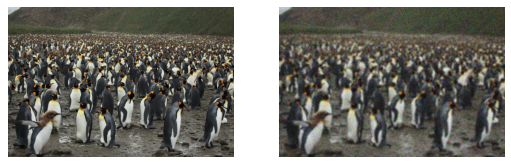

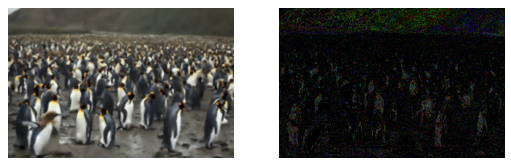

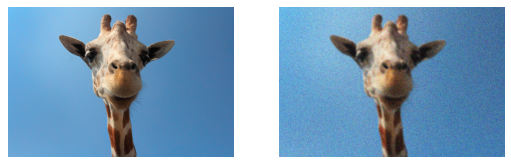

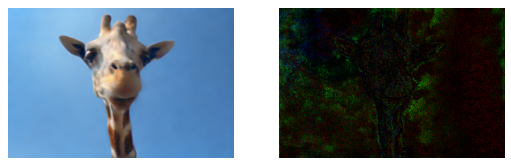

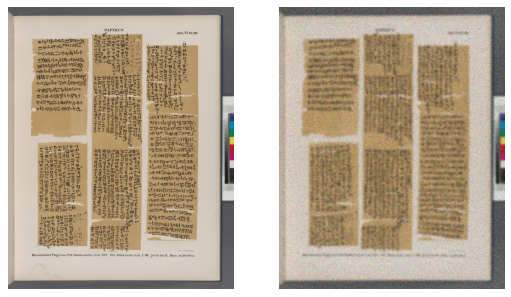

...

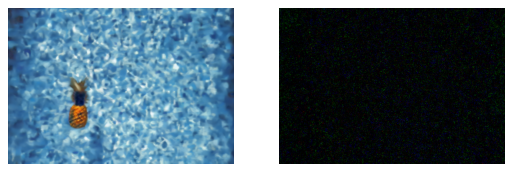

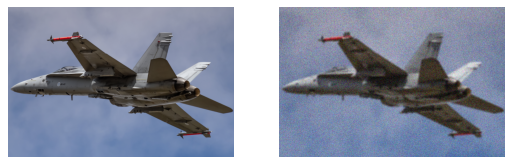

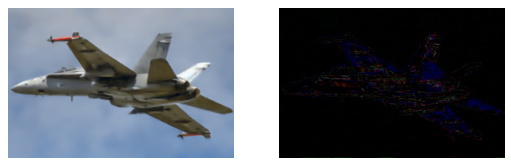

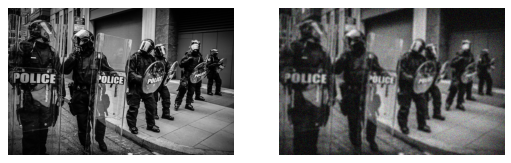

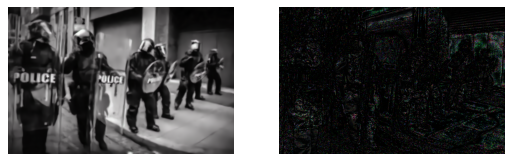

In [45]:
showcaseResults(inputDataSetImages,uploadGaussModImages_Output, gaussianNoisedImages, gaussianSNR, newImageFilenames)

Display Salt and Pepper results.

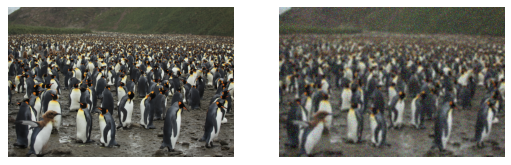

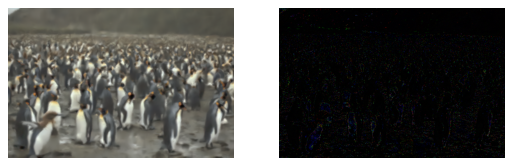

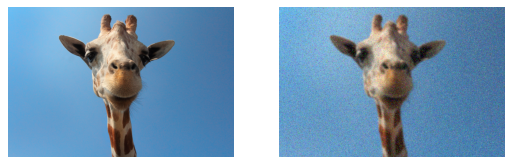

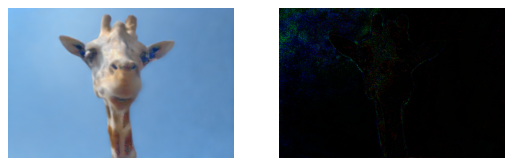

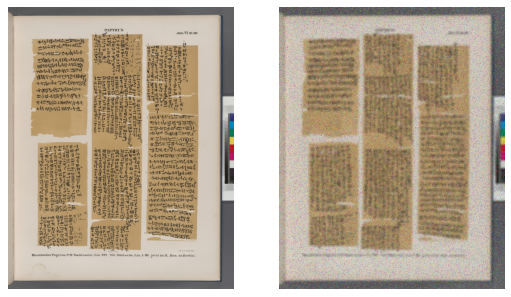

...

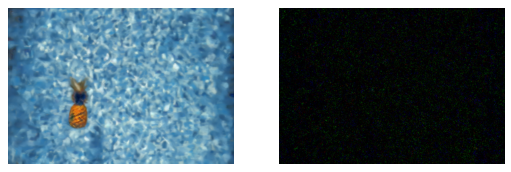

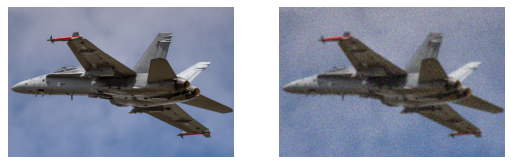

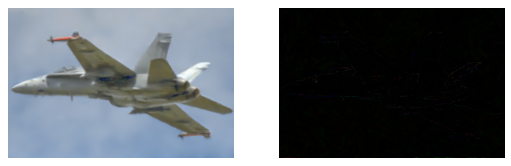

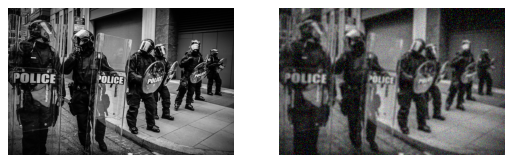

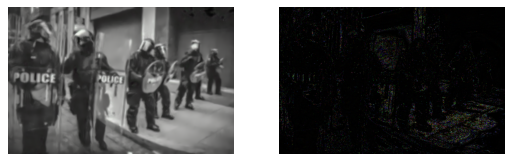

In [46]:
showcaseResults(inputDataSetImages,uploadSaltPepperModImages_Output, saltPepperNoisedImages, spSNR, newImageFilenames)

Display lighter Gaussian noised images.

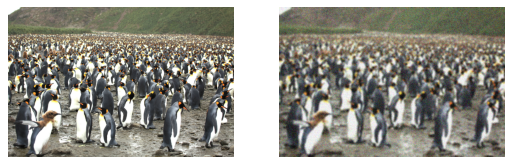

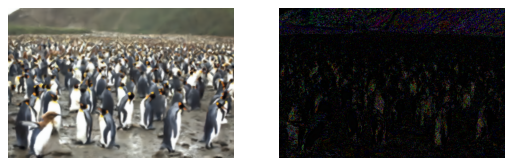

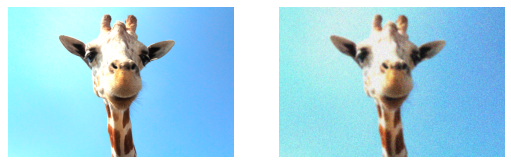

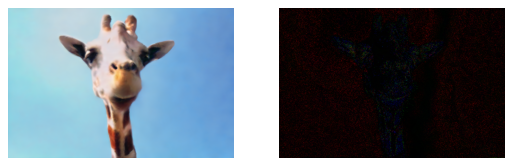

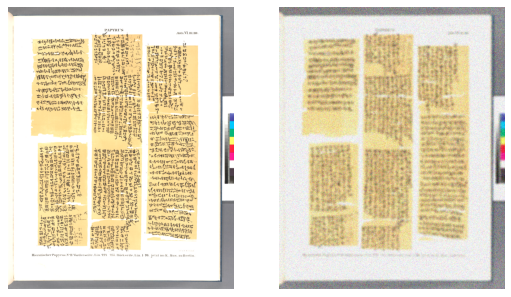

...

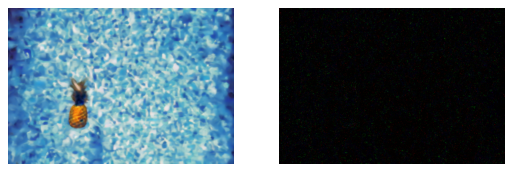

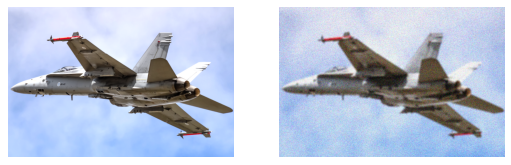

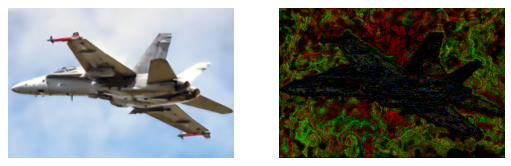

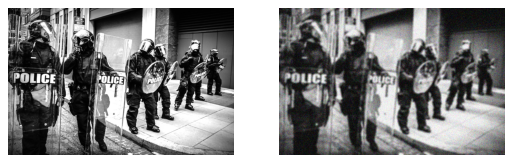

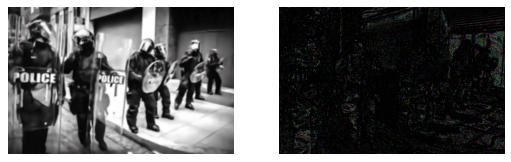

In [47]:
showcaseResults(lighterImages, uploadLighterGaussModImages_Output, gaussianNoisedLighterImages, lightGaussianSNR, newImageFilenames )

#Step 6. Download generated images.

Download zip of images.

In [48]:
from google.colab import files
def downloadImages(imagesDirPath, nameOfTheDir):
  os.system(f"zip -r -j {nameOfTheDir}.zip {imagesDirPath}/*")
  files.download(nameOfTheDir + ".zip")

Download the gaussian noised images.

In [ ]:
downloadImages(uploadGaussModImages,"GaussianNoisedImages")

In [ ]:
downloadImages(os.path.join(uploadGaussModImages_Output,"final_output"),"FixedGaussianNoisedImages")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
downloadImages(gaussianFolderOfSNR, "GaussianNoisedSNR")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Download the salt & pepper images.

In [ ]:
downloadImages(uploadSaltPepperModImages, "SaltPepperNoisedImages")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
downloadImages(os.path.join(uploadSaltPepperModImages_Output,"final_output"),"FixedSaltPepperNoisedImages")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
downloadImages(spFolderOfSNR, "spNoiseSNR")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Download the lighter gaussian noised images.

In [ ]:
downloadImages(uploadLighterGaussModImages, "LighterGaussianNoisedImages")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
downloadImages(os.path.join(uploadLighterGaussModImages_Output,"final_output"), "FixedLighterGaussianNoisedImages")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [49]:
downloadImages(lightGaussianFolderOfSNR, "lighterGaussianNoiseSNR")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Download restored old images.

In [ ]:
downloadImages(os.path.join(uploadOldImages_Output,"final_output"), "fixedOldPhotos")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
downloadImages(os.path.join(uploadOldImages_Output_WithScratches,"final_output"), "fixedOldPhotosWithScratches")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>